In [77]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
import missingno as msno
import janitor
from rfpimp import *
import plotly.express as px


pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

import warnings
warnings.filterwarnings('ignore')

In [2]:
trans_df = pd.read_csv('Data/train_transaction.csv')
#id_df = pd.read_csv('Data/train_identity.csv')

In [80]:
trans_test_df = pd.read_csv('Data/test_transaction.csv')

In [81]:
trans_df.shape, trans_test_df.shape

((590540, 266), (506691, 393))

In [5]:
#trans_df = pd.read_csv('Data/trans_df_drop_corr.csv')

In [79]:
trans_df.isnull().sum().sum()

0

In [82]:
trans_test_df.isnull().sum().sum()

73490163

In [5]:
#trans_test_df = pd.read_csv('Data/test_transaction.csv')

In [6]:
trans_df = trans_df.astype({'card1': 'object', 'card2': 'object', \
                            'card3': 'object', 'card4': 'object',\
                            'card5': 'object', 'card6': 'object',\
                           'addr1':'object', 'addr2': 'object',\
                           'M1': 'object', 'M2': 'object', 'M3': 'object','M4': 'object',\
                           'M5': 'object', 'M6': 'object', 'M7': 'object', 'M8': 'object', 'M9': 'object'})

In [83]:
trans_test_df = trans_test_df.astype({'card1': 'object', 'card2': 'object', \
                            'card3': 'object', 'card4': 'object',\
                            'card5': 'object', 'card6': 'object',\
                           'addr1':'object', 'addr2': 'object',\
                           'M1': 'object', 'M2': 'object', 'M3': 'object','M4': 'object',\
                           'M5': 'object', 'M6': 'object', 'M7': 'object', 'M8': 'object', 'M9': 'object'})

In [ ]:
for i in range(12,39):
    col = 'id_'+ str(i)
    id_df[col] = id_df[col].astype('object')

Missing Value
1. Missing Value Pattern Checking: missingno package
* Missing value rate
* indicator: Add an indicator for same missing pattern
* Impute (numerical):  missing rate < 10% (medium); missing_rate > 10% (mark as -1)
* Impute (categorical):  missing rate < 10% (mode); missing_rate > 10% (mark as NA)

In [ ]:
#Missing Value Pattern Checking
ax = msno.heatmap(trans_df, figsize=(40, 40))

In [ ]:
ax.get_figure().savefig("missing_pattern_metrics_1.png")

In [ ]:
#Missing value rate
trans_df.isnull().mean().sum()

In [ ]:
ax = msno.heatmap(trans_df.loc[:, 'D1':'D15'], figsize=(30, 30))

In [7]:
def missing_at_random(col_start, col_end, missing_rate_high = True, impute_value = -1):
    #Add an indicator for missing value
    trans_df[col_start + '_'+ col_end + '_missing_indicator'] = trans_df[col_start].isnull().astype('int')
    col_name = trans_df.loc[: ,col_start:col_end].columns
    if missing_rate_high: 
        #Fill missing value with impute value (different from existing values)
        trans_df[col_name] = trans_df[col_name].fillna(impute_value)
        
    elif missing_rate_high == False:
        #Fill missing value with medium
        for col in col_name:
            trans_df[col] = trans_df[col].fillna(trans_df[col].median())

In [7]:
def missing_at_random_test(col_start, col_end, missing_rate_high = True, impute_value = -1):
    #Add an indicator for missing value
    trans_df[col_start + '_'+ col_end + '_missing_indicator'] = trans_df[col_start].isnull().astype('int')
    col_name = trans_df.loc[: ,col_start:col_end].columns
    if missing_rate_high: 
        #Fill missing value with impute value (different from existing values)
        trans_df[col_name] = trans_df[col_name].fillna(impute_value)
        
    elif missing_rate_high == False:
        #Fill missing value with medium
        for col in col_name:
            trans_df[col] = trans_df[col].fillna(trans_df[col].median())

In [8]:
missing_at_random('V1', 'V11')

In [9]:
missing_at_random('V12', 'V34')

In [10]:
missing_at_random('V35', 'V52')

In [11]:
missing_at_random('V53', 'V74')

In [12]:
missing_at_random('V75', 'V94')

In [13]:
missing_at_random('V95', 'V137', missing_rate_high = False)

In [14]:
missing_at_random('V138', 'V166')

In [15]:
missing_at_random('V167', 'V278')

In [16]:
missing_at_random('V281', 'V283', missing_rate_high = False)

In [17]:
missing_at_random('V285', 'V287', missing_rate_high = False)

In [18]:
missing_at_random('V290', 'V294', missing_rate_high = False)

In [19]:
missing_at_random('V302', 'V312', missing_rate_high = False)

In [20]:
missing_at_random('V316', 'V321', missing_rate_high = False)

In [21]:
missing_at_random('V322', 'V339')

In [22]:
col_names = ['V300', 'V301', 'V313', 'V314', 'V315']
trans_df['discrete_'+'1'+'_missing_indicator'] = trans_df['V300'].isnull().astype('int')
for col in col_names:
    trans_df[col] = trans_df[col].fillna(trans_df[col].median())

In [23]:
missing_at_random('M1', 'M3', impute_value = 'NA')

In [24]:
col_names = ['M4', 'M5', 'M6']
for col in col_names:
    trans_df[col] = trans_df[col].fillna('NA')

In [25]:
missing_at_random('M7', 'M9', impute_value = 'NA')

In [26]:
col_names = ['D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']
for col in col_names:
    trans_df[col] = trans_df[col].fillna(-1)

In [27]:
trans_df['D1'] = trans_df['D1'].fillna(trans_df['D1'].median())

In [28]:
col_names = ['V279', 'V280', 'V284', 'V288', 'V289', 'V295', 'V296', 'V297', 'V298', 'V299']
trans_df['discrete_'+'2'+'_missing_indicator'] = trans_df['V289'].isnull().astype('int')
for col in col_names:
    trans_df[col] = trans_df[col].fillna(trans_df[col].median())

In [29]:
# Fill card1-6 with mode (categorical variables)
col_names = ['card1', 'card2', 'card3', 'card4', 'card5', 'card6']
for col in col_names:
    trans_df[col] = trans_df[col].fillna(trans_df[col].mode()[0])

In [30]:
col_names =['P_emaildomain', 'R_emaildomain']
for col in col_names:
    trans_df[col] = trans_df[col].fillna('NA')

In [31]:
col_names =['dist1', 'dist2']
for col in col_names:
    trans_df[col] = trans_df[col].fillna(-1)

In [32]:
col_names = ['addr1', 'addr2']
trans_df['addr_missing_indicator'] = trans_df['addr1'].isnull().astype('int')
for col in col_names:
    trans_df[col] = trans_df[col].fillna('NA')

In [36]:
trans_df.isnull().sum().sum()

0

In [37]:
#trans_df.to_csv('trans_df_missing_value.csv', index = False)

In [38]:
# Drop duplicates
trans_df.drop_duplicates(inplace = True)

In [39]:
trans_df.shape

(590540, 413)

Preprocessing
* Multicolinearity
* Encoding categotical

In [40]:
# Select upper triangle of correlation matrix
corr_matrix = trans_df.loc[:,:'V339'].corr()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]
#to_drop = to_drop[1:]
#trans_df.drop(trans_df[to_drop], axis=1, inplace = True)

In [84]:
to_drop

NameError: name 'to_drop' is not defined

In [42]:
to_drop = to_drop[1:]
trans_df.drop(trans_df[to_drop], axis=1, inplace = True)

In [43]:
trans_df.shape

(590540, 248)

In [44]:
#trans_df.to_csv('trans_df_drop_corr.csv', index = False)

Encoding Categorical 

In [47]:
trans_df.select_dtypes(include = ['object']).columns

Index(['ProductCD', 'card4', 'card6', 'addr1', 'addr2', 'P_emaildomain',
       'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9'],
      dtype='object')

In [99]:
trans_df['P_emaildomain'].value_counts()

gmail.com        228355
other            150714
yahoo.com        100934
hotmail.com       45250
anonymous.com     36998
aol.com           28289
Name: P_emaildomain, dtype: int64

In [122]:
px.histogram(trans_df,x = 'addr1' ).update_xaxes(categoryorder =  'total ascending')

In [50]:
trans_df.loc[(trans_df['card3'] != 150) & (trans_df['card3'] != 185), 'card3'] = 'other'

In [51]:
trans_df.loc[(trans_df['addr2'] != 87) , 'addr2'] = 'other' 

In [52]:
trans_df.loc[(trans_df['P_emaildomain'] != 'gmail.com') & (trans_df['P_emaildomain'] != 'yahoo.com') & \
            (trans_df['P_emaildomain'] != 'hotmail.com') & (trans_df['P_emaildomain'] != 'anonymous.com') & \
            (trans_df['P_emaildomain'] != 'aol.com'), 'P_emaildomain'] = 'other'

In [55]:
trans_df.loc[(trans_df['R_emaildomain'] != 'NA') & (trans_df['R_emaildomain'] != 'yahoo.com') & \
            (trans_df['R_emaildomain'] != 'hotmail.com') & (trans_df['R_emaildomain'] != 'anonymous.com') & \
            (trans_df['R_emaildomain'] != 'gmail.com'), 'R_emaildomain'] = 'other'

* One hot: ProductCD, card3(C), card4,card6,  addr2(C), P_emaildomain, R_emaildomain, M4
* value counts: card1, card2, card5, addr1
* Label: M1, M2, M3, M5, M6, M7, M8, M9

In [89]:
one_hot_col = ['ProductCD', 'card3', 'card4','card6',  'addr2', 'P_emaildomain', 'R_emaildomain', 'M4']
freq_count_col = ['addr1']
label_encoder_col = ['M1', 'M2', 'M3', 'M5', 'M6', 'M7', 'M8', 'M9']

In [103]:
trans_df.shape

(590540, 266)

In [112]:
trans_df.shape

(590540, 266)

In [102]:
#One hot encoding
trans_df = pd.get_dummies(trans_df, columns = one_hot_col, drop_first = True)

In [128]:
#Frequency encoding
freq_encoding = pd.DataFrame(trans_df['addr1'].value_counts())
trans_df = pd.merge(trans_df, freq_encoding, left_on = 'addr1', right_index = True)

In [137]:
trans_df.drop(columns = ['addr1_x'], inplace = True)

In [147]:
trans_df.drop(columns = ['addr1'], inplace = True)

In [115]:
#Count encoding
for col in label_encoder_col:
    trans_df.loc[trans_df[col]=='T', col] = 1
    trans_df.loc[trans_df[col]=='F', col] = 0
    trans_df.loc[trans_df[col]=='NA', col] = -1

In [117]:
#trans_df.to_csv('trans_df_after_encoding.csv', index = False)

In [169]:
from sklearn.model_selection import train_test_split
y = trans_df['isFraud']
X = trans_df.drop(columns = ['isFraud'])

In [185]:
X_train,X_test, y_train,y_test = train_test_split(X, encoded_y, test_size=0.20)

In [186]:
X_train.shape,X_test.shape, y_train.shape, y_test.shape

((472432, 265), (118108, 265), (472432,), (118108,))

In [187]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(random_state=42, n_estimators=100, n_jobs=-1)

In [188]:
rf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=42, verbose=0, warm_start=False)

In [34]:
from sklearn.metrics import confusion_matrix
y_pred = rf.predict(X_test)

NameError: name 'rf' is not defined

In [192]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_test, rf.predict_proba(X_test)[:,1])

0.9376290342582771

In [189]:
rf.feature_importances_

array([4.05152634e-02, 4.08740384e-02, 3.49410335e-02, 3.26186660e-02,
       2.62708541e-02, 1.38517954e-02, 1.02718251e-02, 4.68052341e-03,
       3.17555359e-02, 1.84712892e-02, 7.03849284e-05, 3.15447771e-03,
       1.26450575e-02, 6.83648509e-03, 2.55030282e-02, 1.18034113e-02,
       7.06917023e-03, 1.07301606e-02, 6.84389715e-03, 3.63427777e-03,
       2.87995302e-03, 8.07882851e-03, 6.09544866e-03, 1.00640451e-02,
       7.37928667e-03, 3.00321166e-03, 2.18991450e-03, 4.00698997e-03,
       1.37561291e-02, 8.86270813e-04, 2.38701201e-03, 2.98001265e-03,
       3.98582141e-03, 4.86632611e-03, 2.95011131e-03, 3.44517566e-03,
       3.02227564e-03, 8.86557619e-04, 2.64605338e-03, 1.60411025e-03,
       3.70604296e-03, 6.02783856e-04, 7.88477873e-04, 1.31150621e-03,
       3.91600553e-03, 4.01295443e-03, 1.64036466e-03, 3.06645048e-03,
       3.40100340e-03, 2.45410076e-03, 1.06417806e-03, 1.14000695e-02,
       1.82568494e-03, 4.22011912e-03, 2.57052121e-03, 3.52710391e-03,
      

In [195]:
def imp_df(column_names, importances):
    df = pd.DataFrame({'feature': column_names,
                       'feature_importance': importances}) \
           .sort_values('feature_importance', ascending = False) \
           .reset_index(drop = True)
    return df

In [205]:
def var_imp_plot(imp_df, title):
    imp_df.columns = ['feature', 'feature_importance']
    plt.figure(figsize=(20,50))
    sns.barplot(x = 'feature_importance', y = 'feature', data = imp_df, orient = 'h', color = 'royalblue') \
       .set_title(title, fontsize = 20)

In [196]:
base_imp = imp_df(X_train.columns, rf.feature_importances_)

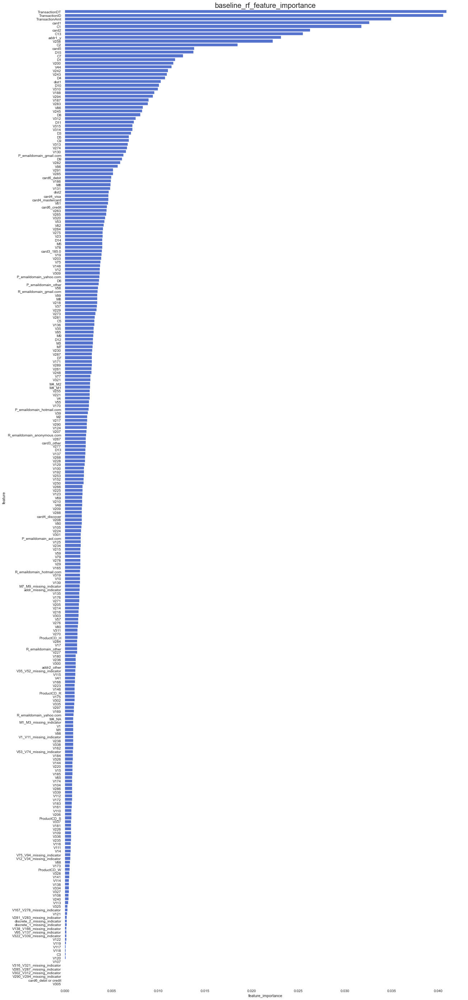

In [206]:
var_imp_plot(base_imp, 'baseline_rf_feature_importance')

In [220]:
trans_df_copy = trans_df.copy()

trans_df_copy.shape

Feature Selection:

* 1.Correlation
* 2.Lasso 
* 3.Recursive Feature Elimination

In [222]:
# Select upper triangle of correlation matrix
corr_matrix_1 = trans_df_copy.corr()
upper_1 = corr_matrix_1.where(np.triu(np.ones(corr_matrix_1.shape), k=1).astype(np.bool))
to_drop_1 = [column for column in upper_1.columns if any(upper_1[column] > 0.95)]

In [224]:
to_drop_1 = to_drop_1[1:]
trans_df_copy.drop(trans_df_copy[to_drop_1], axis=1, inplace = True)

In [250]:
to_drop_1

['C2',
 'M2',
 'M3',
 'V1',
 'V290_V294_missing_indicator',
 'V302_V312_missing_indicator',
 'V316_V321_missing_indicator',
 'V322_V339_missing_indicator',
 'discrete_1_missing_indicator',
 'M1_M3_missing_indicator',
 'discrete_2_missing_indicator',
 'addr2_other']

In [225]:
trans_df_copy.shape, trans_df.shape

((590540, 254), (590540, 266))

In [226]:
from sklearn.model_selection import train_test_split
y_1 = trans_df_copy['isFraud']
X_1 = trans_df_copy.drop(columns = ['isFraud'])

In [227]:
X_train_1,X_test_1, y_train_1,y_test_1 = train_test_split(X_1, y_1, test_size=0.20)

In [228]:
rf_1 = RandomForestClassifier(random_state=42, n_estimators=100, n_jobs=-1)

In [229]:
rf_1.fit(X_train_1, y_train_1)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=42, verbose=0, warm_start=False)

In [231]:
roc_auc_score(y_test_1, rf_1.predict_proba(X_test_1)[:,1])

0.9313903871939317

#Lasso regression for feature selection

In [6]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Lasso, LogisticRegression
from sklearn.feature_selection import SelectFromModel
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score
from yellowbrick.model_selection.importances import feature_importances

In [236]:
trans_df.shape

(590540, 266)

In [8]:
y = trans_df['isFraud']
X = trans_df.drop(columns = ['isFraud'])

In [9]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

In [10]:
X_train.shape,X_test.shape, y_train.shape, y_test.shape

((413378, 265), (177162, 265), (413378,), (177162,))

In [240]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)

In [243]:
sfm_lr = SelectFromModel(LogisticRegression(C=1, penalty='l1', n_jobs=-1))
sfm_lr.fit(X_train_scaled, y_train)

SelectFromModel(estimator=LogisticRegression(C=1, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l1', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False),
        max_features=None, norm_order=1, prefit=False, threshold=None)

In [246]:
selected_feat = X_train.columns[(sfm_lr.get_support())]

In [248]:
print('total features: {}'.format((X_train.shape[1])))
print('selected features: {}'.format(len(selected_feat)))
print('features with coefficients shrank to zero: {}'.format(
      np.sum(sfm_lr.estimator_.coef_ == 0)))

total features: 265
selected features: 255
features with coefficients shrank to zero: 10


In [252]:
to_drop_lr = X_train.columns[(sfm_lr.estimator_.coef_ == 0).ravel().tolist()]

In [251]:
to_drop_1

['C2',
 'M2',
 'M3',
 'V1',
 'V290_V294_missing_indicator',
 'V302_V312_missing_indicator',
 'V316_V321_missing_indicator',
 'V322_V339_missing_indicator',
 'discrete_1_missing_indicator',
 'M1_M3_missing_indicator',
 'discrete_2_missing_indicator',
 'addr2_other']

In [258]:
trans_df_copy_2 = trans_df.copy()

In [260]:
trans_df_copy_2.drop(columns = to_drop_lr, inplace = True)

In [261]:
trans_df_copy_2.shape

(590540, 256)

In [265]:
y_2 = trans_df_copy_2['isFraud']
X_2 = trans_df_copy_2.drop(columns= ['isFraud'])

In [266]:
X_train_2, X_test_2, y_train_2, y_test_2 = train_test_split(X_2, y_2, test_size = 0.3)

In [267]:
X_train_2.shape,X_test_2.shape, y_train_2.shape, y_test_2.shape

((413378, 255), (177162, 255), (413378,), (177162,))

In [268]:
rf_2 = RandomForestClassifier(random_state=42, n_estimators=100, n_jobs=-1)

In [269]:
rf_2.fit(X_train_2, y_train_2)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=42, verbose=0, warm_start=False)

In [270]:
roc_auc_score(y_test_2, rf_2.predict_proba(X_test_2)[:,1])

0.9326780536992959

In [271]:
trans_df_copy_3 = trans_df.copy()

In [273]:
#trans_df_copy_3.drop(columns = to_drop_lr, inplace = True)
to_drop_2 = ['C2',
 'M2',
 'M3',
 'V1',
 'V290_V294_missing_indicator',
 'V302_V312_missing_indicator',
 'V316_V321_missing_indicator',
 'discrete_2_missing_indicator',
 'addr2_other']
trans_df_copy_3.drop(columns = to_drop_2, inplace = True)

In [274]:
trans_df_copy_3.shape

(590540, 247)

In [276]:
y_3 = trans_df_copy_3['isFraud']
X_3 = trans_df_copy_3.drop(columns= ['isFraud'])

In [277]:
X_train_3, X_test_3, y_train_3, y_test_3 = train_test_split(X_3, y_3, test_size = 0.3)

In [278]:
X_train_3.shape,X_test_3.shape, y_train_3.shape, y_test_3.shape

((413378, 246), (177162, 246), (413378,), (177162,))

In [279]:
rf_3 = RandomForestClassifier(random_state=42, n_estimators=100, n_jobs=-1)

In [280]:
rf_3.fit(X_train_3, y_train_3)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=42, verbose=0, warm_start=False)

In [281]:
roc_auc_score(y_test_3, rf_3.predict_proba(X_test_3)[:,1])

0.9302264898634915

In [283]:
from yellowbrick.features import RFECV

In [284]:
y = trans_df['isFraud']
X = trans_df.drop(columns = ['isFraud'])

In [285]:
X.shape

(590540, 265)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2910, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-289-1bb73e6239c5>", line 4, in <module>
    rfe_dt.fit(X, y)
  File "/anaconda3/lib/python3.6/site-packages/yellowbrick/model_selection/rfecv.py", line 194, in fit
    scores.append(cross_val_score(rfe, X, y, **cv_params))
  File "/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 402, in cross_val_score
    error_score=error_score)
  File "/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 240, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/anaconda3/lib/python3.6/site-packages/sklearn/externals/joblib/parallel.py", line 986, in __call__
    while self.dispatch_one_batch(iterator):
  File "/anaconda3/lib/python3.6/site-packages/sklearn/externals/joblib/parallel.py", line 825, in

KeyboardInterrupt: 

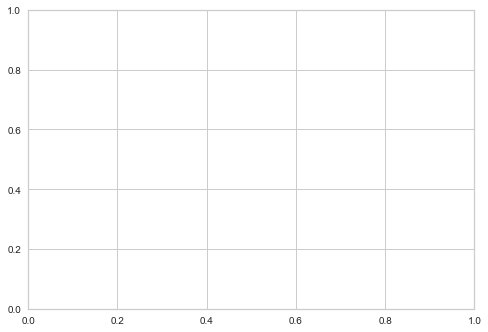

In [289]:
from sklearn.tree import DecisionTreeClassifier
rfe_dt = RFECV(DecisionTreeClassifier(min_samples_leaf=10),
            cv=5)
rfe_dt.fit(X, y)

### ML models

In [10]:
from sklearn.metrics import confusion_matrix

In [11]:
y = trans_df['isFraud']
X = trans_df.drop(columns = 'isFraud')

In [12]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

In [13]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((413378, 265), (177162, 265), (413378,), (177162,))

Logistic Regression

In [7]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

In [40]:
lr = LogisticRegression(penalty = 'l2', solver = 'saga',class_weight = 'balanced', n_jobs = -1)

In [41]:
lr.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=-1, penalty='l2', random_state=None,
          solver='saga', tol=0.0001, verbose=0, warm_start=False)

In [43]:
y_pred_lr = lr.predict(X_test)

In [45]:
pd.DataFrame(confusion_matrix(y_test, y_pred_lr),
             columns = ['Prediction: Not Fraud', 'Prediction: Fraud'],
             index = ['Label: Not Fraud', 'Label: Fraud'])

,Prediction: Not Fraud,Prediction: Fraud
Label: Not Fraud,163607,7359
Label: Fraud,5509,687


In [300]:
lr.intercept_

array([-2.05379198e-11])

In [302]:
def inv_logit(p):
    return np.exp(p) / (1 + np.exp(p))

In [303]:
inv_logit(lr.intercept_)

array([0.5])

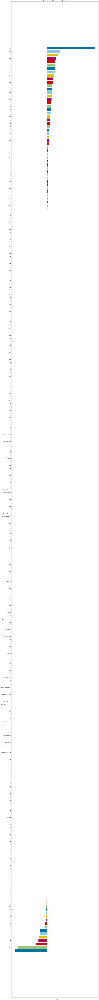

In [313]:
#from yellowbrick.features.importances import FeatureImportances
from yellowbrick.model_selection.importances import feature_importances
fig, ax = plt.subplots(figsize=(20, 200))
lr_imp = feature_importances(lr, X_train)

In [312]:
lr.coef_

array([[-3.41761162e-07,  1.15409620e-09,  2.60502907e-06,
        -1.45204598e-05,  4.44871660e-07, -3.09558277e-07,
        -8.06990635e-08,  9.07254923e-07,  1.03006649e-06,
         1.47344157e-06, -3.97780029e-10, -2.92143876e-07,
         3.93965920e-07, -1.81604105e-07, -7.46282931e-07,
        -3.92185678e-06, -8.34205405e-07, -3.60090023e-06,
        -1.02533222e-06,  2.50442719e-07, -6.79477267e-08,
        -9.64721207e-08,  2.27771644e-08, -4.24423744e-06,
        -3.57506372e-06,  3.42866149e-07, -5.44395181e-08,
         5.36052854e-07, -5.27959273e-06, -2.60522079e-08,
        -2.67629336e-08, -2.64466450e-08,  6.68201076e-09,
        -2.52999334e-08, -1.11069324e-08, -1.52425278e-08,
        -2.08453921e-08, -2.61049712e-08, -2.30676352e-08,
        -2.62366446e-08, -1.26958335e-08, -1.38271042e-08,
         2.92105725e-09,  5.13737625e-09, -9.91495676e-09,
        -4.14653465e-09, -2.55061043e-08, -1.26039615e-08,
         1.33919466e-08,  9.54644395e-09, -9.82410545e-0

In [314]:
roc_auc_score(y_test, lr.predict_proba(X_test)[:,1])

0.6308048684579732

Decision Tree

In [7]:
from sklearn.tree import DecisionTreeClassifier

In [8]:
dt = DecisionTreeClassifier(random_state = 42)

In [12]:
dt.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=42,
            splitter='best')

In [15]:
roc_auc_score(y_test, dt.predict_proba(X_test)[:,1])

0.7847669116490851

In [16]:
roc_auc_score(y_train, dt.predict_proba(X_train)[:,1])

1.0

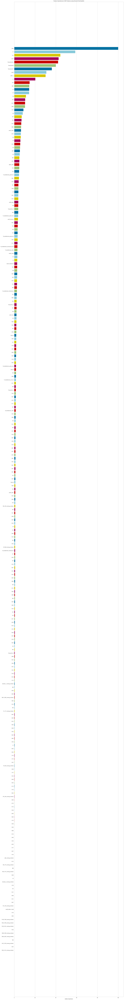

In [18]:
from yellowbrick.model_selection.importances import feature_importances
fig, ax = plt.subplots(figsize=(20, 160))
feat_imp = feature_importances(dt, X)

In [19]:
dt.tree_.max_depth

70

In [28]:
dt.predict_proba(X_test)

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [1., 0.],
       [1., 0.],
       [1., 0.]])

In [320]:
dt_1 = DecisionTreeClassifier(class_weight = 'balanced', random_state = 42)

In [321]:
dt_1.fit(X_train, y_train)

DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=42,
            splitter='best')

In [322]:
roc_auc_score(y_test, dt_1.predict_proba(X_test)[:,1])

0.7579573534186116

In [323]:
roc_auc_score(y_train, dt_1.predict_proba(X_train)[:,1])

1.0

In [333]:
import pydotplus
from io import StringIO
from sklearn.tree import export_graphviz
from sklearn import tree
dot_data = StringIO()

tree.export_graphviz(dt,
                     out_file=dot_data,
                     feature_names=X.columns,
                     class_names=["Non-Fraud", "Fraud"],
                     filled=True)

In [335]:
g = pydotplus.graph_from_dot_data(dot_data.getvalue())
g.write_png("images/mlpr_1002.png")
from IPython.display import Image
Image(g.create_png())

FileNotFoundError: [Errno 2] No such file or directory: 'images/mlpr_1002.png'

In [340]:
from dtreeviz.trees import dtreeviz
viz = dtreeviz(dt,
                              X_train,
                              y_train,
                              target_name="isFraud",
                              feature_names=X.columns,
                              class_names=["Non-Fraud", "Fraud"])

In [344]:
viz.save('decision_tree_graph.svg')

In [ ]:
viz

Random Forest

In [14]:
rf = RandomForestClassifier(random_state = 42, n_jobs =-1)

In [15]:
rf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=-1,
            oob_score=False, random_state=42, verbose=0, warm_start=False)

In [19]:
rf.feature_importance

AttributeError: 'RandomForestClassifier' object has no attribute 'feature_importance'

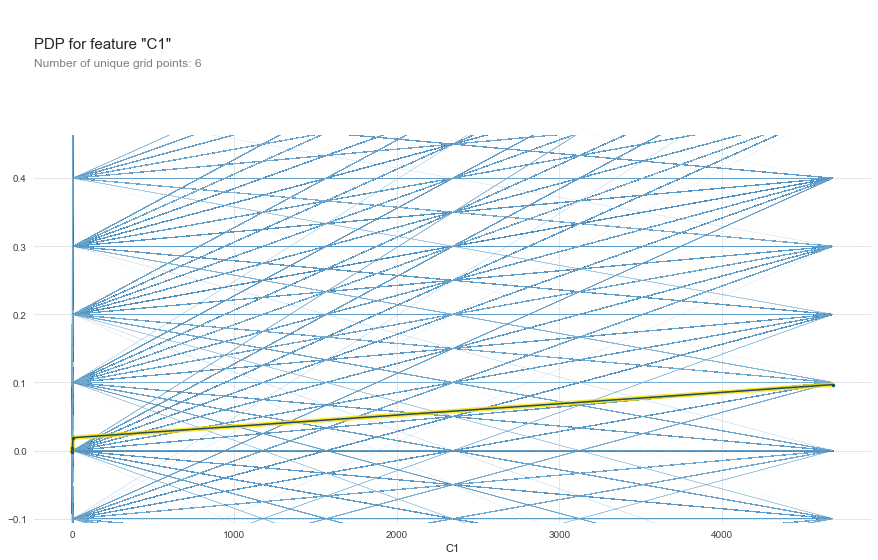

In [20]:
from pdpbox import pdp
feat_name = "C1"
p = pdp.pdp_isolate(rf, X, X.columns, feat_name)
fig, _ = pdp.pdp_plot(p, feat_name, plot_lines=True)

In [46]:
y_pred = rf.predict(X_test)

In [43]:
y_pred_prob = rf.predict_proba(X_test)

In [22]:
roc_auc_score(y_test, rf.predict_proba(X_test)[:,1])

0.8817783871846997

In [23]:
roc_auc_score(y_train, rf.predict_proba(X_train)[:,1])

0.9999723215960189

In [25]:
y_pred

array([0, 0, 0, ..., 0, 0, 0])

In [52]:
y_test.values

array([0, 0, 0, ..., 0, 0, 0])

In [53]:
auc_df = pd.DataFrame(y_pred_prob)
auc_df['y_pred'] = y_pred
auc_df['y_test'] = y_test.values

In [65]:
auc_df = auc_df.sort_values(by = 1, ascending = False)

In [66]:
auc_df

,0,1,y_pred,y_test
146535,0.0,1.0,1,1
55452,0.0,1.0,1,1
92797,0.0,1.0,1,1
47430,0.0,1.0,1,1
70791,0.0,1.0,1,1
...,...,...,...,...
64657,1.0,0.0,0,0
64658,1.0,0.0,0,0
64659,1.0,0.0,0,0
64660,1.0,0.0,0,0


In [56]:
class_count = y_test.value_counts()
pos_count = class_count[1.0]
neg_count = class_count[0.0]

In [59]:
class_count

0    170946
1      6216
Name: isFraud, dtype: int64

In [67]:
#store results here
coords = [(0,0)]
#FPR as horizontal x axis    
fp=0
#TPR as vertical y axis
tp=0

In [68]:
for truth in auc_df['y_test']:
    if truth == 1:
        tp +=1
    else:
        fp +=1
    #update result
    coords.append((fp, tp))

In [69]:
coords

[(0, 0),
 (0, 1),
 (0, 2),
 (0, 3),
 (0, 4),
 (0, 5),
 (0, 6),
 (0, 7),
 (0, 8),
 (0, 9),
 (0, 10),
 (0, 11),
 (0, 12),
 (0, 13),
 (0, 14),
 (0, 15),
 (0, 16),
 (0, 17),
 (0, 18),
 (0, 19),
 (0, 20),
 (0, 21),
 (0, 22),
 (0, 23),
 (0, 24),
 (0, 25),
 (0, 26),
 (0, 27),
 (0, 28),
 (0, 29),
 (0, 30),
 (0, 31),
 (0, 32),
 (0, 33),
 (0, 34),
 (0, 35),
 (0, 36),
 (0, 37),
 (0, 38),
 (0, 39),
 (0, 40),
 (0, 41),
 (0, 42),
 (0, 43),
 (0, 44),
 (0, 45),
 (0, 46),
 (0, 47),
 (0, 48),
 (0, 49),
 (0, 50),
 (0, 51),
 (0, 52),
 (0, 53),
 (0, 54),
 (0, 55),
 (0, 56),
 (0, 57),
 (0, 58),
 (0, 59),
 (0, 60),
 (0, 61),
 (0, 62),
 (0, 63),
 (0, 64),
 (0, 65),
 (0, 66),
 (0, 67),
 (0, 68),
 (0, 69),
 (0, 70),
 (0, 71),
 (0, 72),
 (0, 73),
 (0, 74),
 (0, 75),
 (0, 76),
 (0, 77),
 (0, 78),
 (0, 79),
 (0, 80),
 (0, 81),
 (0, 82),
 (0, 83),
 (0, 84),
 (0, 85),
 (0, 86),
 (0, 87),
 (0, 88),
 (0, 89),
 (0, 90),
 (0, 91),
 (0, 92),
 (0, 93),
 (0, 94),
 (0, 95),
 (0, 96),
 (0, 97),
 (0, 98),
 (0, 99),
 (0, 100),

In [70]:
fp, tp = map(list, zip(*coords))

In [73]:
tpr = tp/pos_count

In [74]:
tpr

array([0.00000000e+00, 1.60875161e-04, 3.21750322e-04, ...,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00])

In [75]:
import rfpimp

In [76]:
rfp_imp = rfpimp.importances(rf, X_test, y_test).Importance

In [77]:
rfp_imp

Feature
C1                              0.0032
V294                            0.0022
C2                              0.0020
C13                             0.0016
TransactionAmt                  0.0014
V187                            0.0014
card2                           0.0014
C7                              0.0012
V283                            0.0012
addr1_y                         0.0012
card6_debit                     0.0010
P_emaildomain_gmail.com         0.0010
card1                           0.0010
D15                             0.0008
V313                            0.0008
V281                            0.0008
V274                            0.0008
V203                            0.0008
V90                             0.0008
V78                             0.0008
TransactionID                   0.0008
D8                              0.0006
V56                             0.0006
R_emaildomain_hotmail.com       0.0006
card6_credit                    0.0006
ProductCD_H      

XG Boost

In [27]:
import xgboost as xgb

In [95]:
trans_df_copy = trans_df.copy()

In [98]:
y_1 = trans_df_copy['isFraud']
X_1 = trans_df_copy.drop(columns = ['isFraud', 'TransactionID'])

In [100]:
X_train_1, X_test_1, y_train_1, y_test_1 = train_test_split(X_1, y_1, test_size = 0.3)

In [101]:
X_train_1.shape, X_test_1.shape, y_train_1.shape, y_test_1.shape

((413378, 264), (177162, 264), (413378,), (177162,))

In [102]:
xgbModel = xgb.XGBClassifier(random_state=42)

In [91]:
xgbModel.fit(X_train,
              y_train,
              early_stopping_rounds=50,
              eval_set=[(X_test, y_test)])

[0]	validation_0-error:0.02829
Will train until validation_0-error hasn't improved in 50 rounds.
[1]	validation_0-error:0.02740
[2]	validation_0-error:0.02756
[3]	validation_0-error:0.02732
[4]	validation_0-error:0.02717
[5]	validation_0-error:0.02695
[6]	validation_0-error:0.02667
[7]	validation_0-error:0.02659
[8]	validation_0-error:0.02638
[9]	validation_0-error:0.02600
[10]	validation_0-error:0.02578
[11]	validation_0-error:0.02566
[12]	validation_0-error:0.02535
[13]	validation_0-error:0.02523
[14]	validation_0-error:0.02507
[15]	validation_0-error:0.02506
[16]	validation_0-error:0.02495
[17]	validation_0-error:0.02493
[18]	validation_0-error:0.02471
[19]	validation_0-error:0.02449
[20]	validation_0-error:0.02425
[21]	validation_0-error:0.02411
[22]	validation_0-error:0.02406
[23]	validation_0-error:0.02390
[24]	validation_0-error:0.02380
[25]	validation_0-error:0.02362
[26]	validation_0-error:0.02343
[27]	validation_0-error:0.02339
[28]	validation_0-error:0.02330
[29]	validation_

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
       importance_type='gain', interaction_constraints='',
       learning_rate=0.300000012, max_delta_step=0, max_depth=6,
       min_child_weight=1, missing=nan, monotone_constraints='()',
       n_estimators=100, n_jobs=0, num_parallel_tree=1,
       objective='binary:logistic', random_state=42, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
       validate_parameters=1, verbosity=None)

In [92]:
roc_auc_score(y_train, xgbModel.predict_proba(X_train)[:,1])

0.9578202427756018

In [93]:
roc_auc_score(y_test, xgbModel.predict_proba(X_test)[:,1])

0.9378472387383097

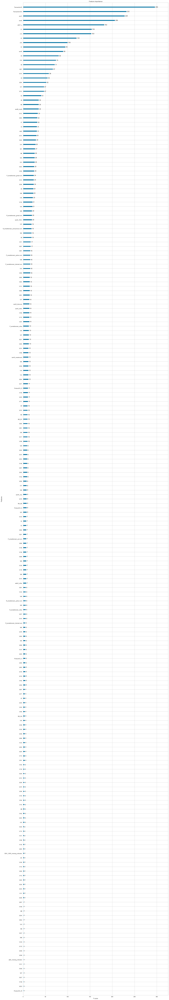

In [94]:
fig, ax = plt.subplots(figsize=(20, 140))
xgb.plot_importance(xgbModel, ax=ax)

In [103]:
xgbModel_1 = xgb.XGBClassifier(random_state=42)

In [104]:
xgbModel_1.fit(X_train_1,
              y_train_1,
              early_stopping_rounds=50,
              eval_set=[(X_test_1, y_test_1)])

[0]	validation_0-error:0.02788
Will train until validation_0-error hasn't improved in 50 rounds.
[1]	validation_0-error:0.02744
[2]	validation_0-error:0.02690
[3]	validation_0-error:0.02679
[4]	validation_0-error:0.02661
[5]	validation_0-error:0.02632
[6]	validation_0-error:0.02611
[7]	validation_0-error:0.02598
[8]	validation_0-error:0.02591
[9]	validation_0-error:0.02566
[10]	validation_0-error:0.02543
[11]	validation_0-error:0.02512
[12]	validation_0-error:0.02513
[13]	validation_0-error:0.02487
[14]	validation_0-error:0.02480
[15]	validation_0-error:0.02465
[16]	validation_0-error:0.02451
[17]	validation_0-error:0.02442
[18]	validation_0-error:0.02437
[19]	validation_0-error:0.02415
[20]	validation_0-error:0.02381
[21]	validation_0-error:0.02369
[22]	validation_0-error:0.02350
[23]	validation_0-error:0.02335
[24]	validation_0-error:0.02333
[25]	validation_0-error:0.02319
[26]	validation_0-error:0.02304
[27]	validation_0-error:0.02300
[28]	validation_0-error:0.02278
[29]	validation_

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
       importance_type='gain', interaction_constraints='',
       learning_rate=0.300000012, max_delta_step=0, max_depth=6,
       min_child_weight=1, missing=nan, monotone_constraints='()',
       n_estimators=100, n_jobs=0, num_parallel_tree=1,
       objective='binary:logistic', random_state=42, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
       validate_parameters=1, verbosity=None)

In [105]:
roc_auc_score(y_train_1, xgbModel_1.predict_proba(X_train_1)[:,1])

0.9590344683581159

In [106]:
roc_auc_score(y_test_1, xgbModel_1.predict_proba(X_test_1)[:,1])

0.9378087313042831

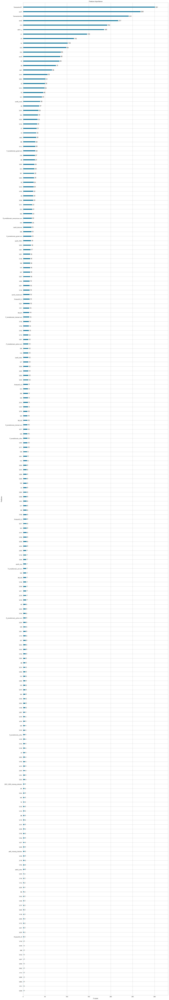

In [107]:
fig, ax = plt.subplots(figsize=(20, 140))
xgb.plot_importance(xgbModel_1, ax=ax)

Light GBM

In [2]:
import lightgbm as lgb

In [11]:
lgbm_model = lgb.LGBMClassifier(random_state = 42)
lgbm_model.fit(X_train, y_train)

In [12]:
lgbm_model.fit(X_train, y_train)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        learning_rate=0.1, max_depth=-1, min_child_samples=20,
        min_child_weight=0.001, min_split_gain=0.0, n_estimators=100,
        n_jobs=-1, num_leaves=31, objective=None, random_state=42,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
        subsample_for_bin=200000, subsample_freq=1)

In [13]:
roc_auc_score(y_test, lgbm_model.predict_proba(X_test)[:, 1])

0.9253102325167155

In [14]:
roc_auc_score(y_train, lgbm_model.predict_proba(X_train)[:, 1])

0.9348830185314667

Grid Search

In [15]:
from yellowbrick.model_selection import ValidationCurve

KeyboardInterrupt: 

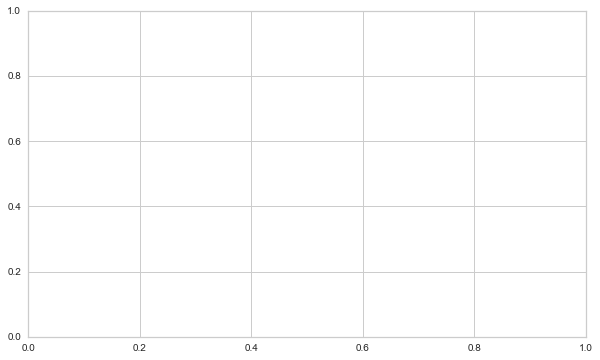

In [28]:
from yellowbrick.model_selection import ValidationCurve
fig, ax = plt.subplots(figsize=(10, 6))
rf_vc_viz = ValidationCurve(
    RandomForestClassifier(n_estimators=30),
    param_name="max_depth",
    param_range=np.arange(1, 20, 4),
    scoring = 'roc_auc',
    cv=5,
    n_jobs=-1)
rf_vc_viz.fit(X, y)

ValidationCurve(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x121c7c710>,
        cv=5, groups=None, logx=False, model=None, n_jobs=-1,
        param_name='max_depth', param_range=array([ 1,  5,  9, 13, 17]),
        pre_dispatch='all', scoring='roc_auc')

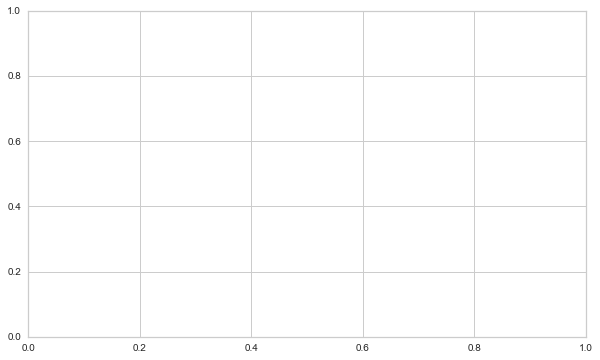

In [30]:
fig, ax = plt.subplots(figsize=(10, 6))
xgb_vc_viz = ValidationCurve(
    xgb.XGBClassifier(max_depth=30),
    param_name="n_estimators",
    param_range=np.arange(1, 100, 10),
    scoring = 'roc_auc',
    cv=5,
    n_jobs=-1)
rf_vc_viz.fit(X, y)

In [31]:
xgb_vc_viz.fit(X, y)

KeyboardInterrupt: 

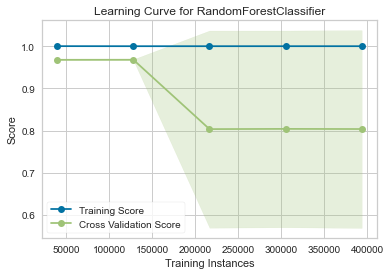

In [25]:
from yellowbrick.model_selection import LearningCurve
fig, ax = plt.subplots(figsize=(6, 4))
lc3_viz = LearningCurve(
    RandomForestClassifier(n_estimators=40),
    cv=3)
lc3_viz.fit(X, y)
lc3_viz.poof()

PCA 
* Feature Engineering
* Data visulization

In [22]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import (
    StandardScaler)

In [23]:
pca = PCA(random_state=42)
X_train_pca = pca.fit_transform(
    StandardScaler().fit_transform(X_train))

In [24]:
X_train_pca = pca.fit_transform(
    StandardScaler().fit_transform(X_train))

In [41]:
pca.explained_variance_ratio_

array([2.00290787e-01, 7.67477722e-02, 7.25569924e-02, 3.68747623e-02,
       3.53904734e-02, 2.93949546e-02, 2.57638381e-02, 2.36090355e-02,
       2.17251381e-02, 1.67568910e-02, 1.63724754e-02, 1.58872203e-02,
       1.51087751e-02, 1.49796429e-02, 1.41468871e-02, 1.33961682e-02,
       1.19544832e-02, 1.14704651e-02, 1.11721179e-02, 1.05205267e-02,
       9.96918678e-03, 9.33989701e-03, 8.42141830e-03, 8.29453127e-03,
       7.99903305e-03, 7.56967248e-03, 7.42637311e-03, 7.07631456e-03,
       6.78250848e-03, 6.65163872e-03, 6.37569951e-03, 6.23428067e-03,
       5.84176300e-03, 5.64800284e-03, 5.28922640e-03, 4.94451959e-03,
       4.92618033e-03, 4.76642404e-03, 4.67200128e-03, 4.47399836e-03,
       4.44332423e-03, 4.30398897e-03, 4.26377688e-03, 4.15229120e-03,
       4.06850637e-03, 3.96696082e-03, 3.88977766e-03, 3.83475620e-03,
       3.81783007e-03, 3.77352286e-03, 3.76281515e-03, 3.73391906e-03,
       3.64837297e-03, 3.56728355e-03, 3.53716236e-03, 3.49505909e-03,
      

[Text(0, 0.5, 'Percent of Explained variance'),
 Text(0.5, 0, 'Component'),
 Text(0.5, 1.0, 'Scree Plot')]

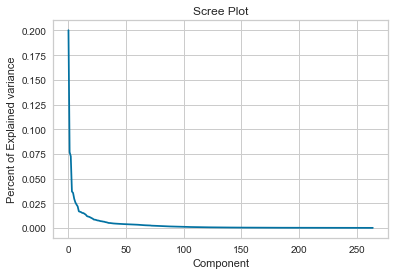

In [30]:
fig, ax = plt.subplots(figsize=(6, 4))
ax.plot(pca.explained_variance_ratio_)
ax.set(xlabel="Component",
       ylabel="Percent of Explained variance",
       title="Scree Plot",
      )

[Text(0, 0.5, 'Percent of Explained variance'),
 Text(0.5, 0, 'Component'),
 Text(0.5, 1.0, 'PCA Variance Cumulation Plot')]

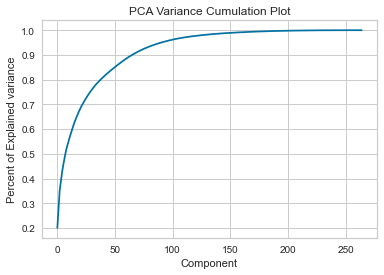

In [33]:
fig, ax = plt.subplots(figsize=(6, 4))
ax.plot(np.cumsum(pca.explained_variance_ratio_))
ax.set(xlabel="Component",
       ylabel="Percent of Explained variance",
       title="PCA Variance Cumulation Plot",
      )

In [34]:
pca.components_

array([[-2.94726509e-02, -2.85766392e-02, -1.14187651e-02, ...,
         3.00673540e-02,  3.31089147e-02,  2.68909814e-02],
       [ 3.49943535e-02,  3.50666128e-02,  1.24602608e-02, ...,
         6.76712354e-03, -1.98173169e-02,  4.83603284e-03],
       [-6.09601823e-03, -4.87381635e-03,  2.38869065e-02, ...,
        -1.71221226e-01,  9.19673705e-02, -1.29977594e-01],
       ...,
       [-0.00000000e+00,  7.28266296e-18, -2.52052703e-17, ...,
        -2.02600573e-19, -2.89817185e-17,  2.01140650e-17],
       [-0.00000000e+00,  4.23691165e-19,  6.81457506e-18, ...,
        -5.09108891e-17, -2.06371520e-17,  8.17936282e-19],
       [-0.00000000e+00,  5.01378499e-18,  5.92950418e-18, ...,
         1.24570006e-17,  1.99748916e-17,  3.21814776e-17]])

array([[-3.20164202, -0.59042456],
       [-2.7464585 , -0.10526579],
       [ 5.81023367, -0.07635499],
       ...,
       [15.15269067, -4.73267569],
       [-4.41706654,  0.20287451],
       [ 2.25589168,  0.80709682]])

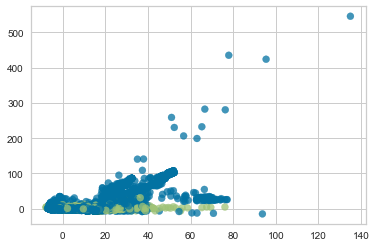

In [35]:
from yellowbrick.features.pca import (PCADecomposition)
fig, ax = plt.subplots(figsize=(6, 4))
colors = ["rg"[j] for j in y]
pca_viz = PCADecomposition(color=colors)
pca_viz.fit_transform(X_train, y_train)

array([[-3.20164202, -0.59043661],
       [-2.7464585 , -0.10527405],
       [ 5.81023367, -0.07634989],
       ...,
       [15.15269067, -4.73267686],
       [-4.41706654,  0.2028757 ],
       [ 2.25589168,  0.80710684]])

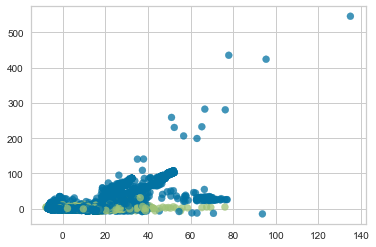

In [38]:
from yellowbrick.features.pca import (PCADecomposition)
fig, ax = plt.subplots(figsize=(6, 4))
colors = ["rg"[j] for j in y]
pca3_viz = PCADecomposition(color=colors, proj_dim=3)
pca3_viz.fit_transform(X_train, y_train)

In [44]:
import scprep
scprep.plot.rotate_scatter3d(
    X_train_pca[:, :3],
    c=y_train,
    cmap="Spectral",
    figsize=(8, 6),
    label_prefix="Principal Component 3d",
)

In [54]:
pca_95 = PCA(n_components = 0.95, random_state=42)
sta_scaler = StandardScaler()
X_train_scaled = sta_scaler.fit_transform(X_train)
X_train_pca_95 = pca_95.fit_transform(X_train_scaled)

In [56]:
X_test_scaled = sta_scaler.transform(X_test)
X_test_pca_95 = pca_95.transform(X_test_scaled)

In [55]:
len(X_train_pca_95[0])

92

In [58]:
len(X_test_pca_95)

177162

In [49]:
X_train.shape

(413378, 265)

In [64]:
from sklearn.ensemble import RandomForestClassifier
rf_pca = RandomForestClassifier(random_state = 42)
rf_pca.fit(X_train_pca_95, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=42, verbose=0, warm_start=False)

In [65]:
roc_auc_score(y_test, rf_pca.predict_proba(X_test_pca_95)[:, 1])

0.8289780121078485

In [66]:
import lightgbm as lgb

In [67]:
lgbm_model = lgb.LGBMClassifier(random_state = 42)
lgbm_model.fit(X_train_pca_95, y_train)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        learning_rate=0.1, max_depth=-1, min_child_samples=20,
        min_child_weight=0.001, min_split_gain=0.0, n_estimators=100,
        n_jobs=-1, num_leaves=31, objective=None, random_state=42,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
        subsample_for_bin=200000, subsample_freq=1)

In [68]:
roc_auc_score(y_test, lgbm_model.predict_proba(X_test_pca_95)[:, 1])

0.8786678133682639

Clustering
* K-means

In [69]:
from sklearn.cluster import KMeans

In [71]:
inertias = []
sizes = range(2, 15)
for k in sizes:
    kmeans = KMeans(random_state=42, n_clusters=k, n_jobs = -1)
    kmeans.fit(X_train_scaled)
    inertias.append(kmeans.inertia_)

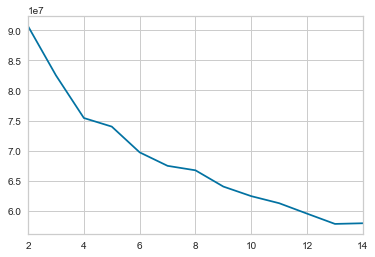

In [72]:
fig, ax = plt.subplots(figsize=(6, 4))
pd.Series(inertias, index=sizes).plot(ax=ax)

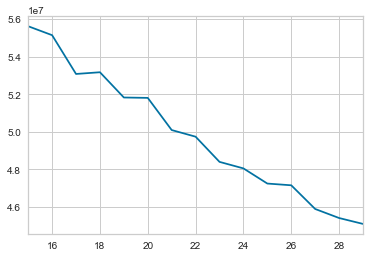

In [74]:
inertias_1 = []
sizes = range(15, 30)
for k in sizes:
    kmeans = KMeans(random_state=42, n_clusters=k, n_jobs = -1)
    kmeans.fit(X_train_scaled)
    inertias_1.append(kmeans.inertia_)
fig, ax = plt.subplots(figsize=(6, 4))
pd.Series(inertias_1, index=sizes).plot(ax=ax)